In [1]:
# In this file, different photos of celebrities will be used to 
# generate fake images using generative adversarial network (GAN)
# reference to tutorial: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# set random seed for reproducibility
manual_seed = 999
# manual_seed = random.randint(1, 10000)      # if you want new results
random.seed(manual_seed)
torch.manual_seed(manual_seed)

In [2]:
# Dataset is available on http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html

# define inputs
root_dir = "./data/celeba"    # root directory for dataset
workers = 2                             # number of workers for dataloader
batch_size = 129                        # batch size used during training
image_size = 64                         # spatial size of training images ...
                                        # all images will be resized to this size using transformer

nc = 3                                  # number of channels (RGB)
nz = 100                                # size of generator input (latent vector)
ngf = 64                                # size of feature maps in generator
ndf = 64                                # size of feature maps in discriminator
num_epochs = 1                          # number of training epochs
lr = 0.0005                             # learning rate for optimizers
beta1 = 0.5                             # hyperparameter for Adam optimizers
ngpu = 0                                # number of GPUs available, use 0 for CPUs

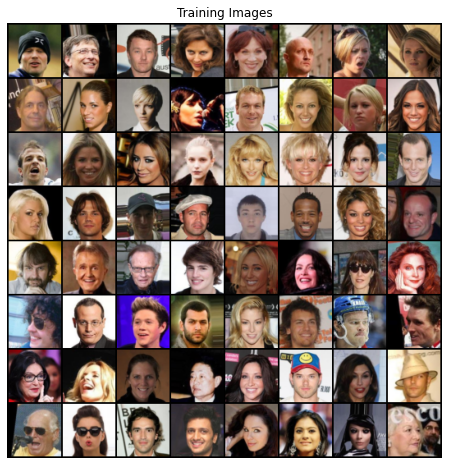

In [3]:
# create the dataset
dataset = dset.ImageFolder(
    root=root_dir,
    transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize(
            (0.5, 0.5, 0.5),
            (0.5, 0.5, 0.5)
        )
    ])
)

# create the dataloader
dataloader = torch.utils.data.DataLoader(
    dataset=dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=workers
)

# decide whether to run training on GPU or CPU
device = torch.device(
    "cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(
    np.transpose(
        vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),
        (1, 2, 0)
    )
)

In [4]:
# weight initialization
# all model weights should be initialized with mean=0, std=0.02

def weight_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
# generator is used to map latent space vector (z) to data space
# training images have size 3 x image_size x image_size
# the output is fed through tanh function to return in to input data range [-1, 1]

# generator class
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [6]:
# create a generator
network_generator = Generator(ngpu).to(device)

# handle multiple GPUs if selected
if (device.type == 'cuda') and (ngpu > 1):
    network_generator = nn.DataParallel(
        module=Generator,
        device_ids=range(len(ngpu))
    )

# instantiate all weights
network_generator.apply(weight_init)

# print the model
print("generator model: ", network_generator)

generator model:  Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (

In [7]:
# create discriminator
# probability is outputted via final sigmoid function
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# create a discriminator
network_discriminator = Discriminator(ngpu).to(device)

# handle multiple GPUs if selected
if (device.type == 'cuda') and (ngpu > 1):
    network_discriminator = nn.DataParallel(
        module=Discriminator,
        device_ids=range(len(ngpu))
    )

# instantiate all weights
network_discriminator.apply(weight_init)

# print the model
print("discriminator model: ", network_discriminator)

discriminator model:  Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [9]:
# BCE loss function
criterion = nn.BCELoss()

# batch of latent vectors will be used to visualize progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# convention for real and fake labels
real_label = 1.
fake_label = 0.

# setup Adam optimizers for both generator and discriminator
optimizer_generator = optim.Adam(
    network_generator.parameters(),
    lr=lr,
    betas=(beta1, 0.999)
)

optimizer_discriminator = optim.Adam(
    network_discriminator.parameters(),
    lr=lr,
    betas=(beta1, 0.999)
)

In [10]:
# training step
image_list = []
generator_losses = []
discriminator_losses = []
iters = 0

print('Starting training ...')
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader):
    
        # discriminator network update:
        # maximize log(D(x)) + log(1 - D(G(z)))

        network_discriminator.zero_grad()

        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        # forward pass real batch through discriminator
        output = network_discriminator(real_cpu).view(-1)

        # calculate loss on all-real batch
        err_discriminator_real = criterion(output, label)

        # calculate gradients for discriminator in backward pass
        err_discriminator_real.backward()

        # D(x) the average output (across the batch) of the discriminator for the all real batch
        # This should start close to 1 then theoretically converge to 0.5 when G gets better
        D_x = output.mean().item()

        # train with all-fake batch

        # generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        # generate fake image batch with generator
        fake = network_generator(noise)
        label.fill_(fake_label)

        # classify all fake batch with discriminator
        output = network_discriminator(fake.detach()).view(-1)

        # calculate discriminator's loss on the all-fake batch
        err_discriminator_fake = criterion(output, label)

        # calculate the gradients for this batch, accumulated (summed) with previous gradients
        err_discriminator_fake.backward()

        # D(G(z)) average discriminator outputs for the all fake batch. 
        # The first number is before D is updated and the second number is after D is updated. 
        # These numbers should start near 0 and converge to 0.5 as G gets better.
        D_G_z1 = output.mean().item()

        # Compute error of discriminator as sum over the fake and the real batches
        err_discriminator = err_discriminator_real + err_discriminator_fake

        # update discriminator
        optimizer_discriminator.step()

        # update generator network: maximize log(D(G(z)))
        optimizer_generator.zero_grad()

        # fake labels are real for generator cost
        label.fill_(real_label)

        # perform another forward pass of all-fake batch through discriminator
        output = network_discriminator(fake).view(-1)

        # calculate generator's loss based on this output
        err_generator = criterion(output, label)

        # calculate generator's gradients
        err_generator.backward()

        # D(G(z)) average discriminator outputs for the all fake batch. 
        # The first number is before D is updated and the second number is after D is updated. 
        # These numbers should start near 0 and converge to 0.5 as G gets better.
        D_G_z2 = output.mean().item()

        # update generator
        optimizer_generator.step()

        if i % 50 == 0:
            print(f'''[{epoch:d}/{num_epochs:d}][{i:d}/{len(dataloader):d}]\t
                Loss_D: {err_discriminator.item():.4f}\tLoss_G: {err_generator.item():.4f}\t
                D(x): {D_x:.4f}\tD(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}''')

        generator_losses.append(err_generator.item())
        discriminator_losses.append(err_discriminator.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = network_generator(fixed_noise).detach().cpu()
            image_list.append(
                vutils.make_grid(fake, padding=2, normalize=True))



Starting training ...
[0/1][0/1571]	
                Loss_D: 1.7201	Loss_G: 13.2068	
                D(x): 0.5542	D(G(z)): 0.5839 / 0.0000
[0/1][50/1571]	
                Loss_D: 0.4776	Loss_G: 3.2380	
                D(x): 0.8705	D(G(z)): 0.1772 / 0.0785
[0/1][100/1571]	
                Loss_D: 1.3973	Loss_G: 6.5248	
                D(x): 0.8979	D(G(z)): 0.6549 / 0.0032
[0/1][150/1571]	
                Loss_D: 3.9306	Loss_G: 3.5962	
                D(x): 0.0654	D(G(z)): 0.0039 / 0.0521
[0/1][200/1571]	
                Loss_D: 1.0832	Loss_G: 4.0882	
                D(x): 0.7748	D(G(z)): 0.4854 / 0.0322
[0/1][250/1571]	
                Loss_D: 0.9223	Loss_G: 2.3828	
                D(x): 0.5873	D(G(z)): 0.1904 / 0.1156
[0/1][300/1571]	
                Loss_D: 1.2710	Loss_G: 2.2409	
                D(x): 0.4013	D(G(z)): 0.0748 / 0.1573
[0/1][350/1571]	
                Loss_D: 1.0696	Loss_G: 1.7383	
                D(x): 0.5487	D(G(z)): 0.2611 / 0.2210
[0/1][400/1571]	
                Los

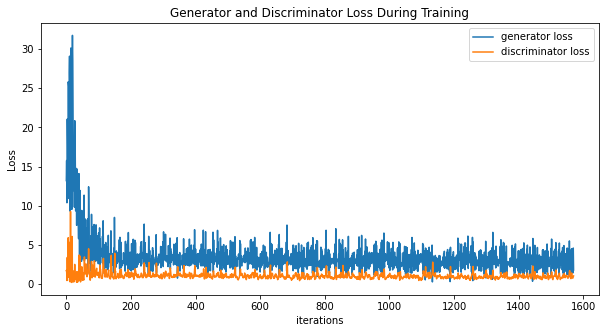

In [11]:
# plot results
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generator_losses, label="generator loss")
plt.plot(discriminator_losses, label="discriminator loss")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21361395 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


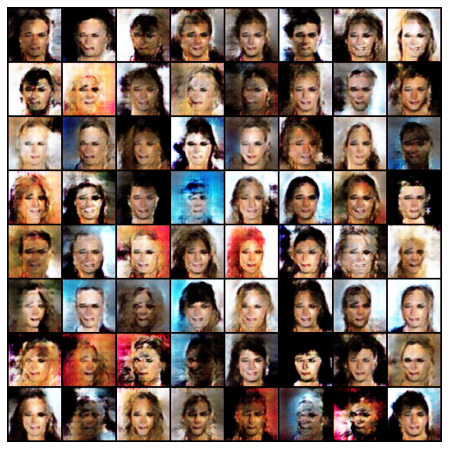

In [12]:
# visualize training progression
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] 
        for i in image_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

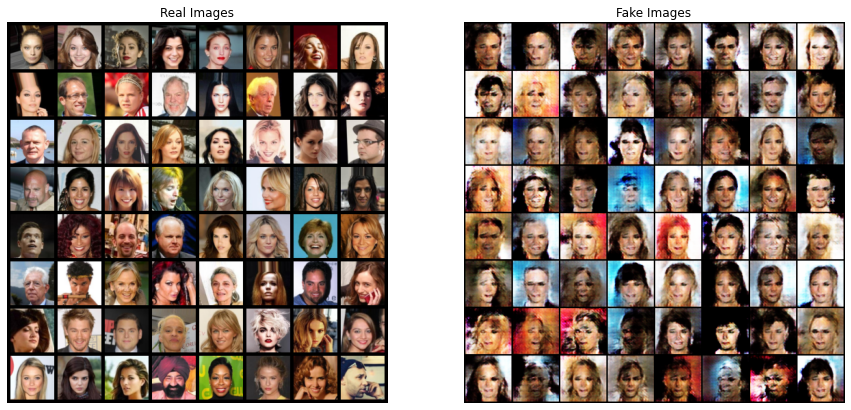

In [13]:
# plot real and fake images

# grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# plot the real images
plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(
    np.transpose(
        vutils.make_grid(
            real_batch[0].to(device)[:64], 
            padding=5, 
            normalize=True).cpu(),
            (1,2,0)
        )
    )

# plot the fake images from the last epoch
plt.subplot(1, 2, 2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(
    np.transpose(
        image_list[-1],
        (1,2,0)
    )
)
plt.show()

In [14]:
# save training model
model_path = "./celeb_dcgan_dis.pt"
torch.save(network_discriminator, model_path)

model_path = "./celeb_dcgan_gen.pt"
torch.save(network_generator, model_path)